Initial Position: [0 0]


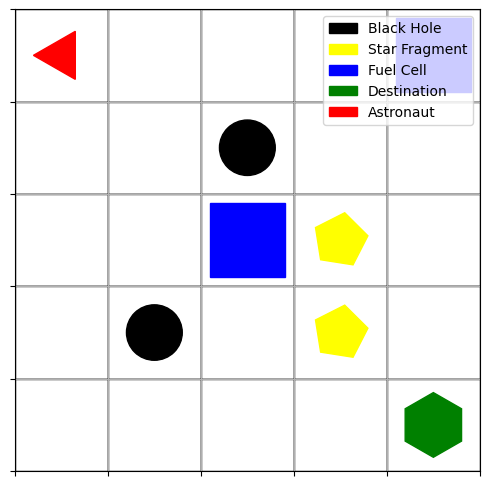


Astronaut's Journey Begins:

Step 1:
  Action Taken: Down
  New Position: [1 0]
  Reward Received: -1
  Mission Status: In Progress


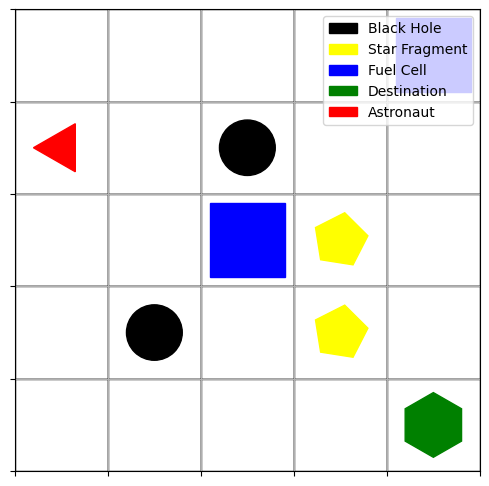

Step 2:
  Action Taken: Left
  New Position: [1 0]
  Reward Received: -1
  Mission Status: In Progress


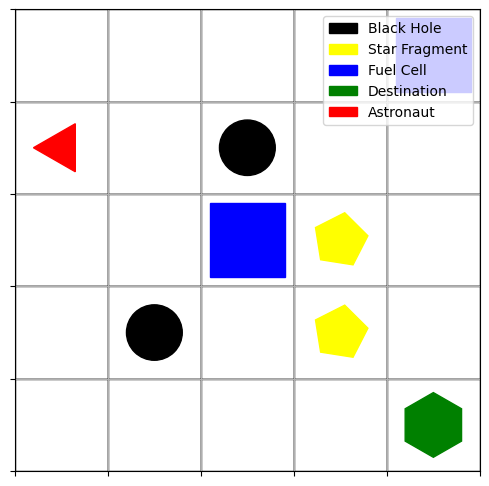

Step 3:
  Action Taken: Up
  New Position: [0 0]
  Reward Received: -1
  Mission Status: In Progress


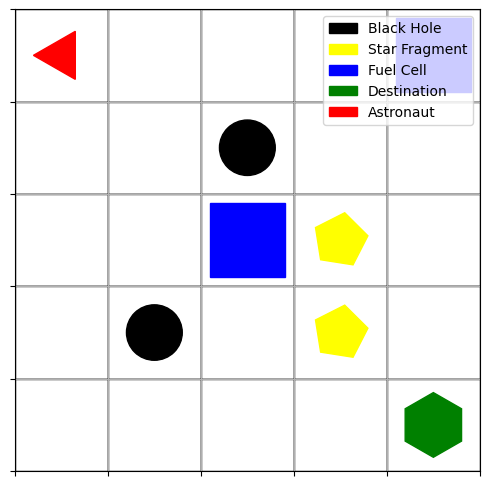

Step 4:
  Action Taken: Right
  New Position: [0 1]
  Reward Received: -1
  Mission Status: In Progress


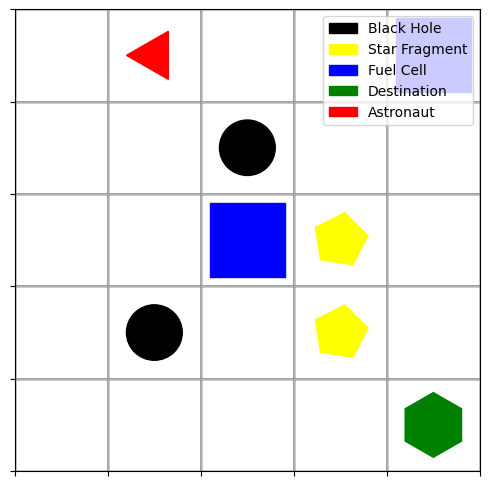

Step 5:
  Action Taken: Left
  New Position: [0 0]
  Reward Received: -1
  Mission Status: In Progress


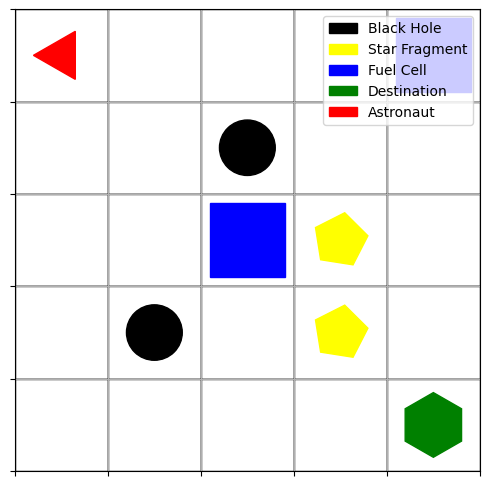

Step 6:
  Action Taken: Right
  New Position: [0 1]
  Reward Received: -1
  Mission Status: In Progress


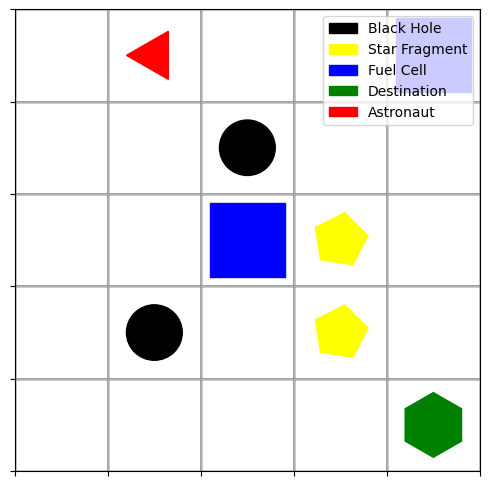

Step 7:
  Action Taken: Right
  New Position: [0 2]
  Reward Received: -1
  Mission Status: In Progress


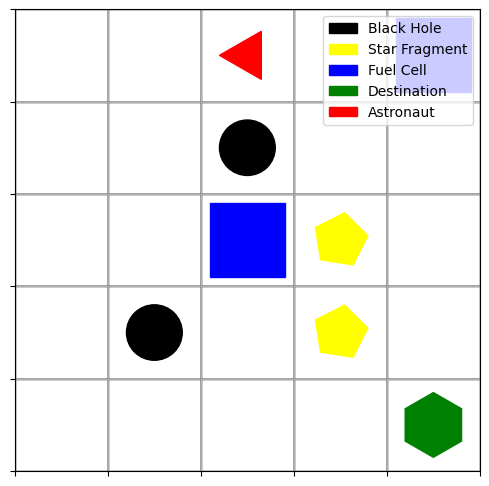

Step 8:
  Action Taken: Right
  New Position: [0 3]
  Reward Received: -1
  Mission Status: In Progress


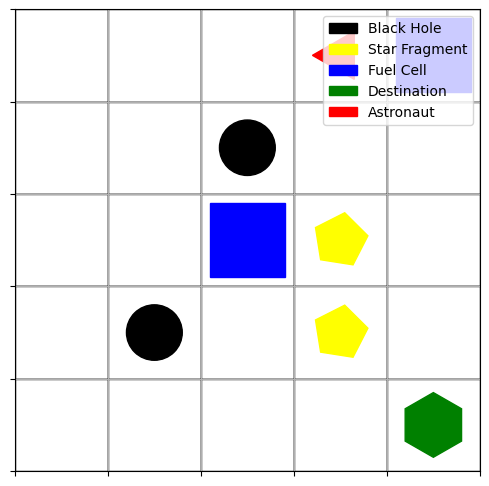

Step 9:
  Action Taken: Left
  New Position: [0 2]
  Reward Received: -1
  Mission Status: In Progress


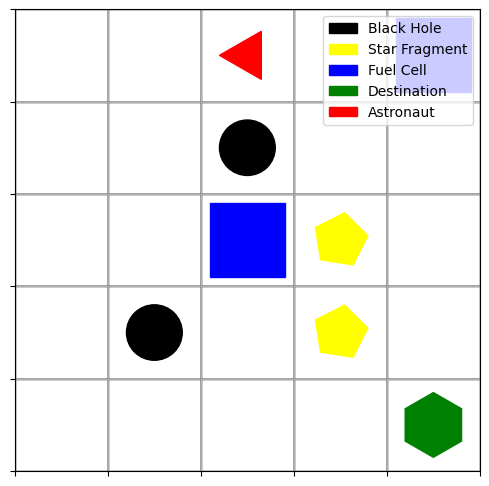

Step 10:
  Action Taken: Right
  New Position: [0 3]
  Reward Received: -1
  Mission Status: In Progress


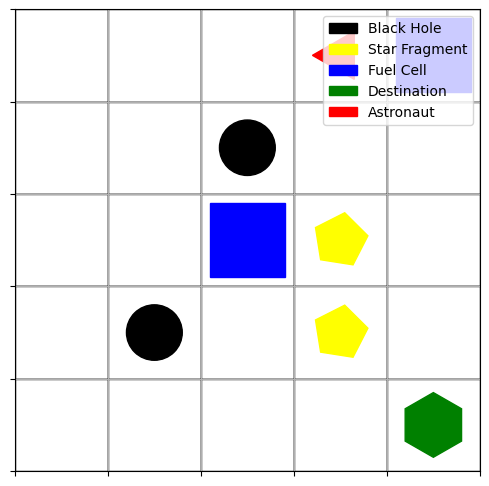

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from gym import Env
from gym.spaces import Discrete, Box

class SpaceMissionEnv(Env):
    def __init__(self):
        super().__init__()
        self.grid_size = (5, 5)
        self.action_space = Discrete(4)
        self.observation_space = Box(low=0, high=max(self.grid_size)-1, shape=(2,), dtype=np.int32)


        self.state = np.array([0, 0])
        self.destination = np.array([4, 4])
        self.black_holes = [np.array([1, 2]), np.array([3, 1])]
        self.star_fragments = [np.array([2, 3]), np.array([3, 3])]
        self.fuel_cells = [np.array([0, 4]), np.array([2, 2])]

        self.rewards = {
            "reach_destination": 100,
            "black_hole": -50,
            "collect_star_fragment": 30,
            "collect_fuel_cell": 10,
            "move_penalty": -1
        }

    def reset(self):
        self.state = np.array([0, 0])
        self.star_fragments = [np.array([2, 3]), np.array([3, 3])]
        self.fuel_cells = [np.array([0, 4]), np.array([2, 2])]
        return self.state.copy()

    def step(self, action):
        action_dict = {
            0: np.array([-1, 0]),
            1: np.array([1, 0]),
            2: np.array([0, -1]),
            3: np.array([0, 1])
        }
        new_state = self.state + action_dict[action]
        new_state = np.clip(new_state, [0, 0], np.array(self.grid_size) - 1)

        self.state = new_state
        reward = self.rewards["move_penalty"]
        done = False

        if np.array_equal(self.state, self.destination):
            reward += self.rewards["reach_destination"]
            done = True
        elif any(np.array_equal(self.state, bh) for bh in self.black_holes):
            reward += self.rewards["black_hole"]
            done = True
        elif any(np.array_equal(self.state, sf) for sf in self.star_fragments):
            reward += self.rewards["collect_star_fragment"]
            self.star_fragments = [sf for sf in self.star_fragments if not np.array_equal(sf, self.state)]
        elif any(np.array_equal(self.state, fc) for fc in self.fuel_cells):
            reward += self.rewards["collect_fuel_cell"]
            self.fuel_cells = [fc for fc in self.fuel_cells if not np.array_equal(fc, self.state)]

        return self.state.copy(), reward, done, {}

    def render(self):
        fig, ax = plt.subplots(figsize=(6, 6))
        ax.set_xlim(-0.5, self.grid_size[1] - 0.5)
        ax.set_ylim(-0.5, self.grid_size[0] - 0.5)
        ax.set_xticks(np.arange(-0.5, self.grid_size[1], 1))
        ax.set_yticks(np.arange(-0.5, self.grid_size[0], 1))
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.grid(True)
        ax.invert_yaxis()

        for x in range(self.grid_size[1]):
            for y in range(self.grid_size[0]):
                rect = patches.Rectangle((x - 0.5, y - 0.5), 1, 1, linewidth=1, edgecolor='black', facecolor='white')
                ax.add_patch(rect)

        for bh in self.black_holes:
            ax.add_patch(patches.Circle((bh[1], bh[0]), radius=0.3, color='black', label='Black Hole'))

        for sf in self.star_fragments:
            ax.add_patch(patches.RegularPolygon((sf[1], sf[0]), numVertices=5, radius=0.3,
                                                orientation=np.pi/4, color='yellow', label='Star Fragment'))

        for fc in self.fuel_cells:
            ax.add_patch(patches.Rectangle((fc[1] - 0.4, fc[0] - 0.4), 0.8, 0.8, color='blue', label='Fuel Cell'))

        ax.add_patch(patches.RegularPolygon((self.destination[1], self.destination[0]), numVertices=6,
                                            radius=0.35, orientation=0, color='green', label='Destination'))

        ax.add_patch(patches.RegularPolygon((self.state[1], self.state[0]), numVertices=3, radius=0.3,
                                            orientation=np.pi/2, color='red', label='Astronaut'))

        handles, labels = ax.get_legend_handles_labels()
        by_label = dict(zip(labels, handles))
        ax.legend(by_label.values(), by_label.keys(), loc='upper right')

        plt.show()
        plt.close(fig)

env = SpaceMissionEnv()

state = env.reset()
print(f"Initial Position: {state}")
env.render()

print("\nAstronaut's Journey Begins:\n")
for t in range(10):
    action = env.action_space.sample()
    next_state, reward, done, _ = env.step(action)
    action_name = ['Up', 'Down', 'Left', 'Right'][action]

    print(f"Step {t+1}:")
    print(f"  Action Taken: {action_name}")
    print(f"  New Position: {next_state}")
    print(f"  Reward Received: {reward}")
    print(f"  Mission Status: {'In Progress' if not done else 'Completed' if reward >= 0 else 'Failed'}")

    env.render()

    if done:
        if reward >= 0:
            print("Success! The astronaut has reached the destination planet.")
        else:
            print("Oh no! The astronaut fell into a black hole.")
        break


Episode 1 Begins: Initial Position [0 0]
  Step 1: Action Right, New Position [0 1], Reward -1


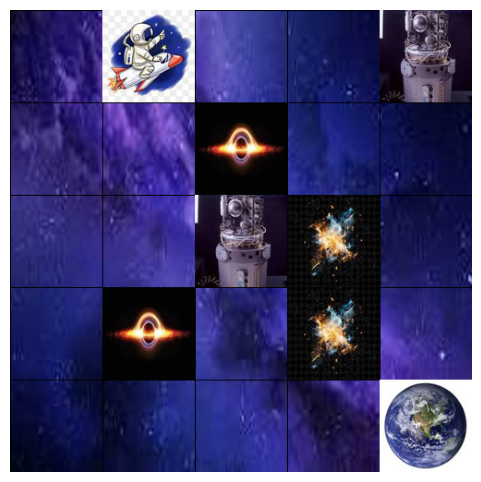

  Step 2: Action Left, New Position [0 0], Reward -1


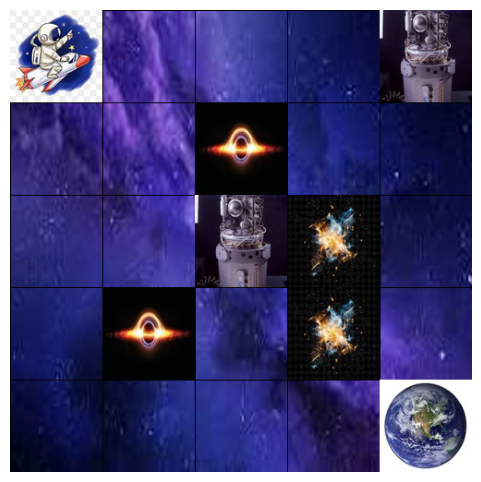

  Step 3: Action Down, New Position [1 0], Reward -1


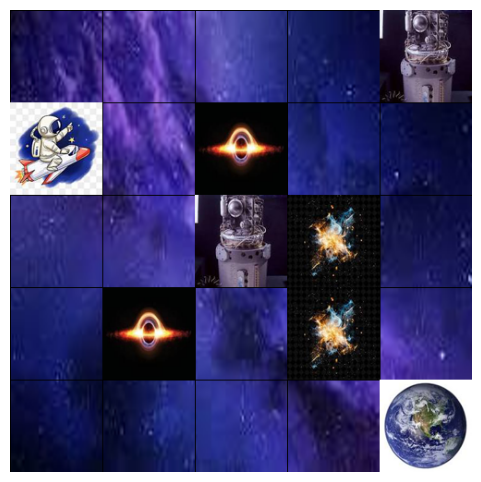

  Step 4: Action Right, New Position [1 1], Reward -1


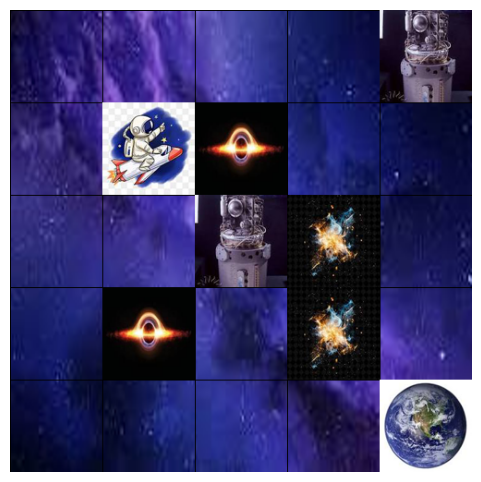

  Step 5: Action Left, New Position [1 0], Reward -1


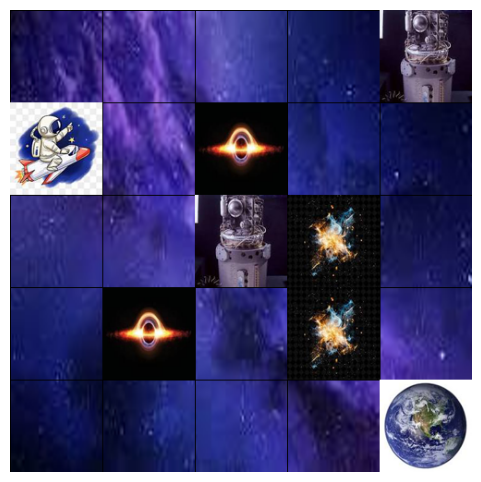

  Step 6: Action Left, New Position [1 0], Reward -1


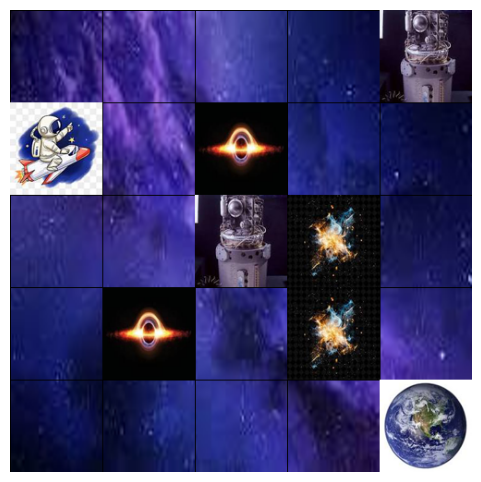

  Step 7: Action Down, New Position [2 0], Reward -1


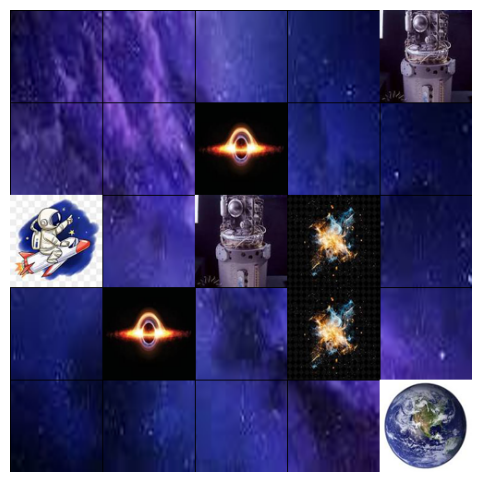

  Step 8: Action Up, New Position [1 0], Reward -1


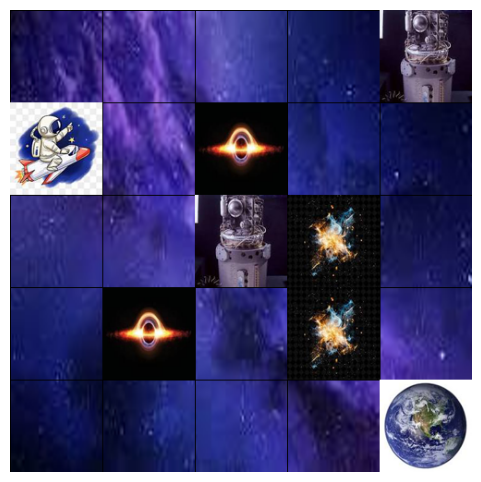

  Step 9: Action Left, New Position [1 0], Reward -1


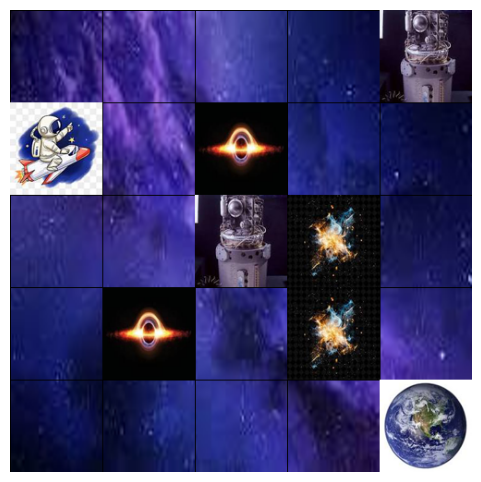

  Step 10: Action Down, New Position [2 0], Reward -1


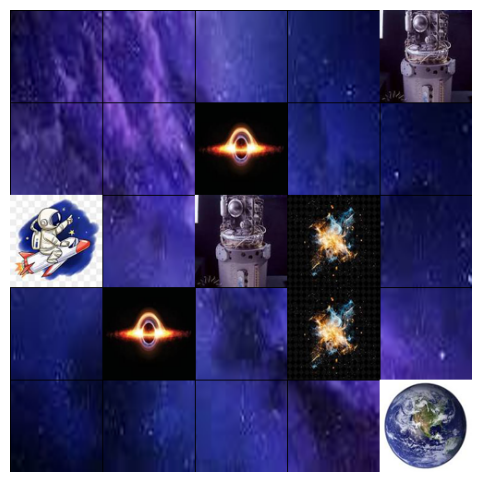



Episode 2 Begins: Initial Position [0 0]
  Step 1: Action Up, New Position [0 0], Reward -1


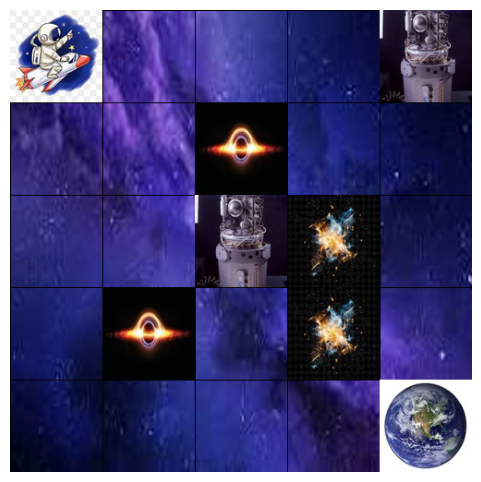

  Step 2: Action Down, New Position [1 0], Reward -1


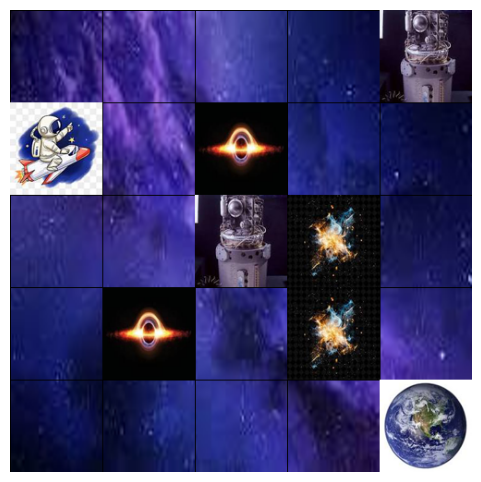

  Step 3: Action Left, New Position [1 0], Reward -1


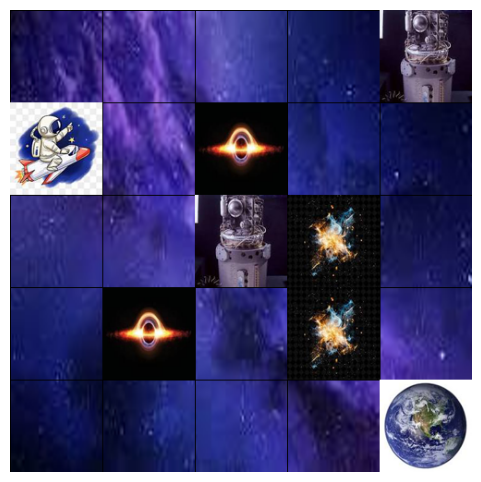

  Step 4: Action Down, New Position [2 0], Reward -1


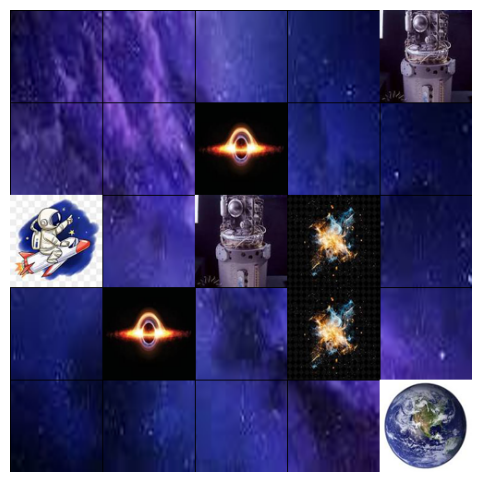

  Step 5: Action Left, New Position [2 0], Reward -1


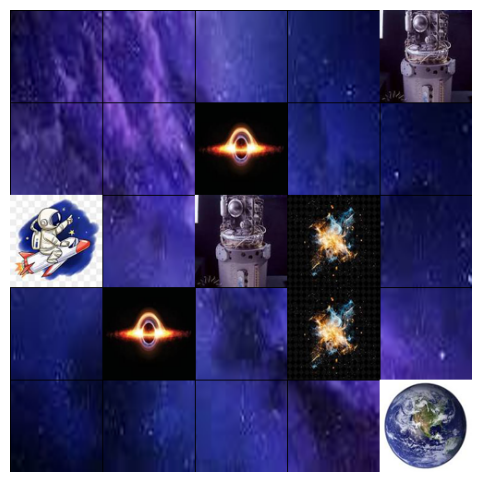

  Step 6: Action Right, New Position [2 1], Reward -1


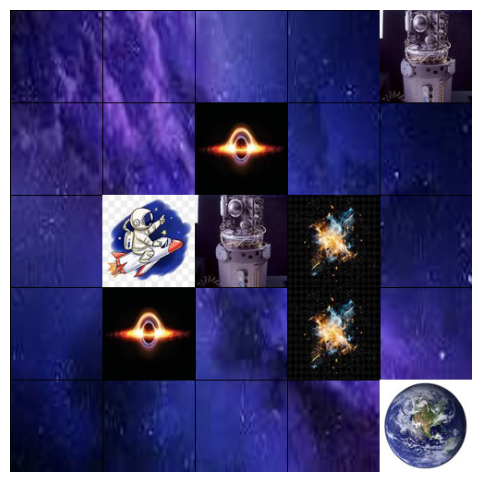

  Step 7: Action Right, New Position [2 2], Reward 9


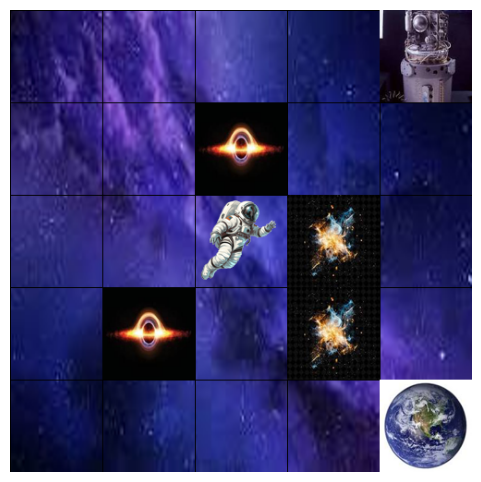

  Step 8: Action Right, New Position [2 3], Reward 29


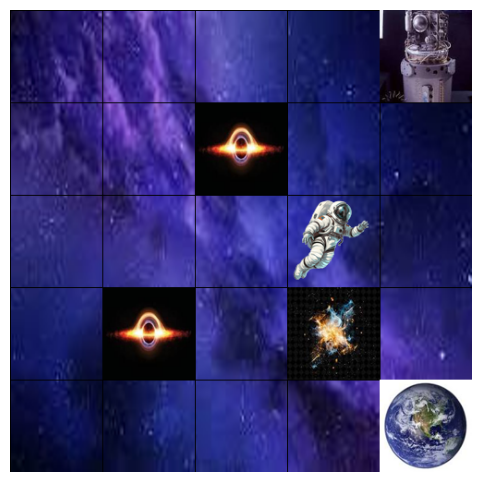

  Step 9: Action Up, New Position [1 3], Reward -1


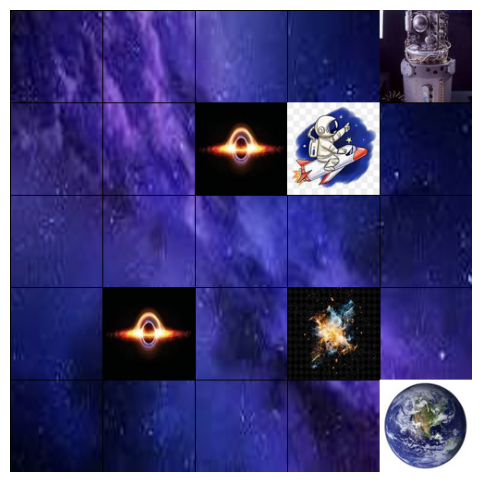

  Step 10: Action Left, New Position [1 2], Reward -51


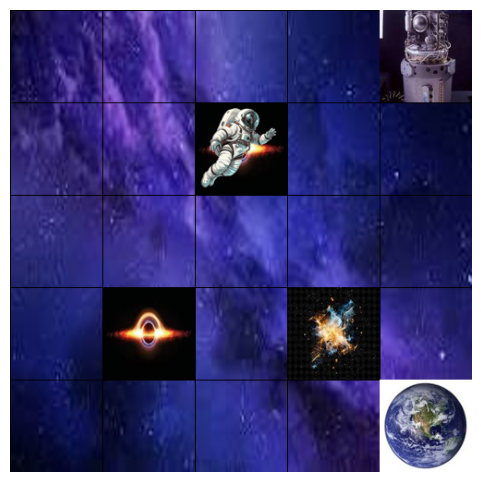

  Failure! Fell into a black hole.


Episode 3 Begins: Initial Position [0 0]
  Step 1: Action Up, New Position [0 0], Reward -1


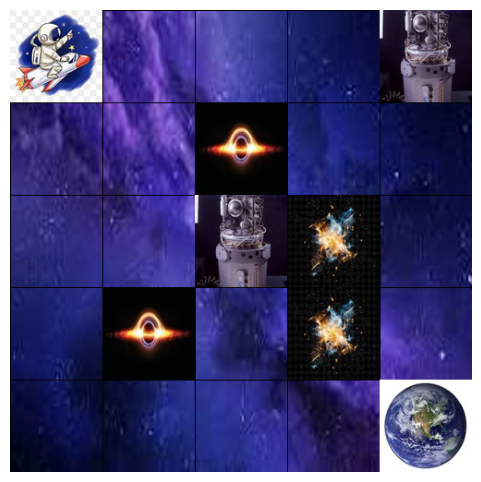

  Step 2: Action Up, New Position [0 0], Reward -1


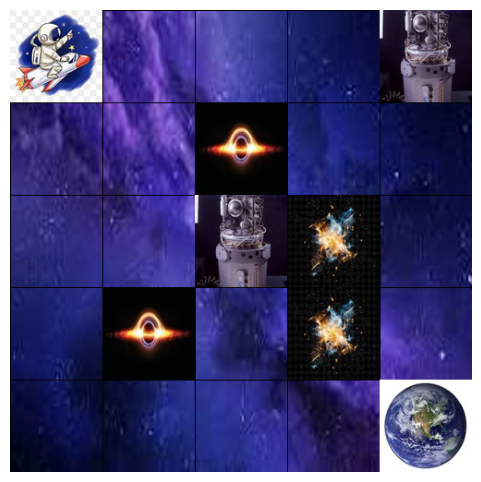

  Step 3: Action Down, New Position [1 0], Reward -1


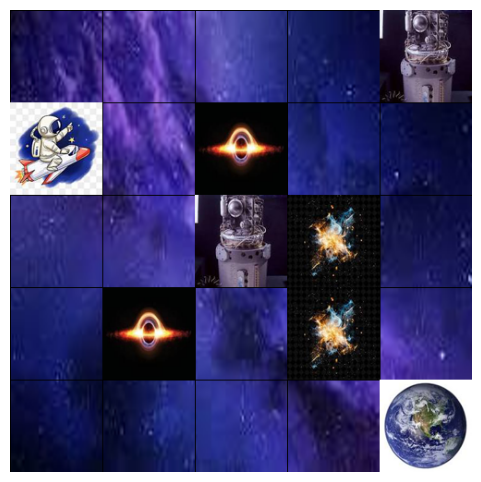

  Step 4: Action Left, New Position [1 0], Reward -1


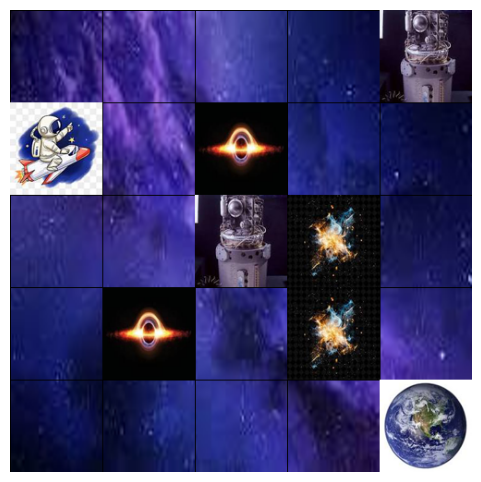

  Step 5: Action Up, New Position [0 0], Reward -1


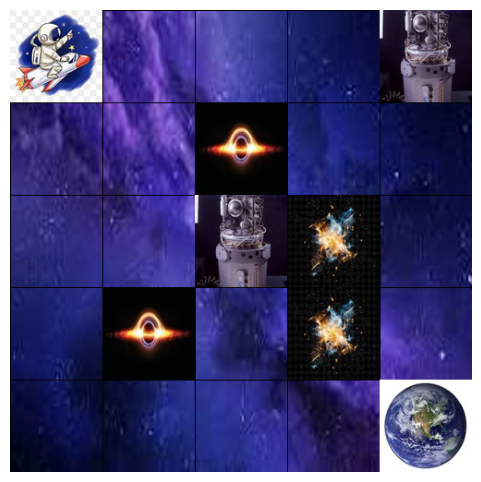

  Step 6: Action Down, New Position [1 0], Reward -1


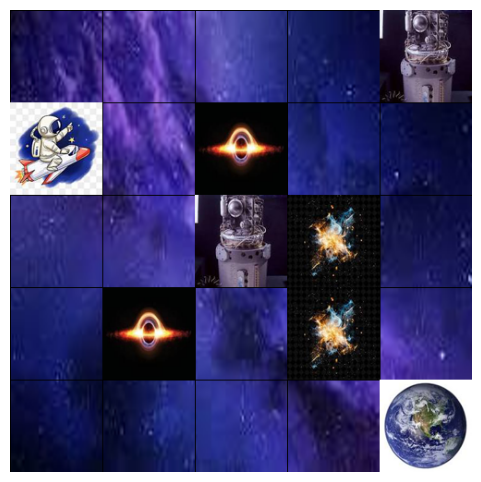

  Step 7: Action Up, New Position [0 0], Reward -1


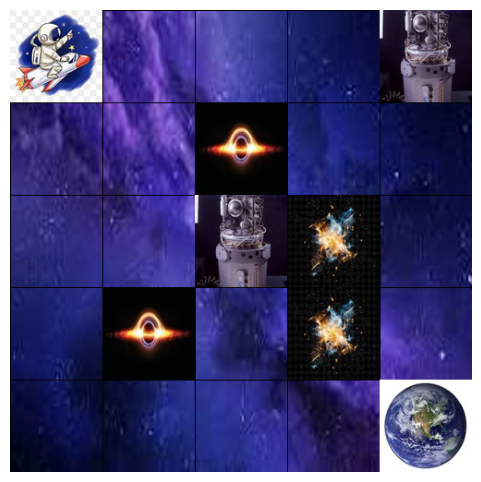

  Step 8: Action Up, New Position [0 0], Reward -1


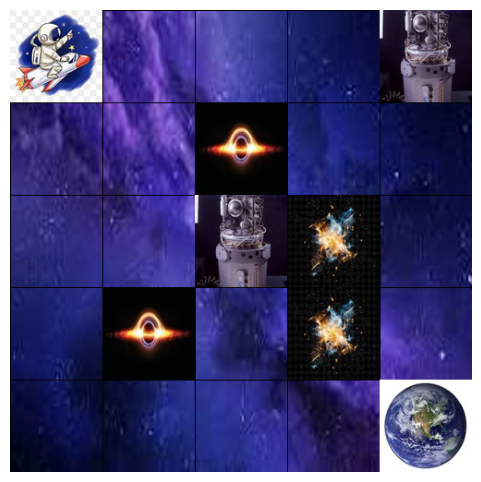

  Step 9: Action Down, New Position [1 0], Reward -1


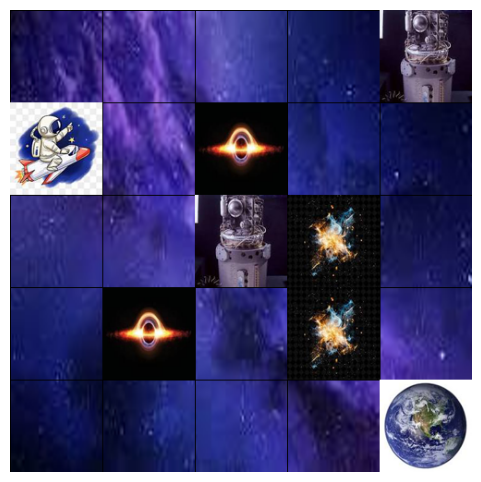

  Step 10: Action Down, New Position [2 0], Reward -1


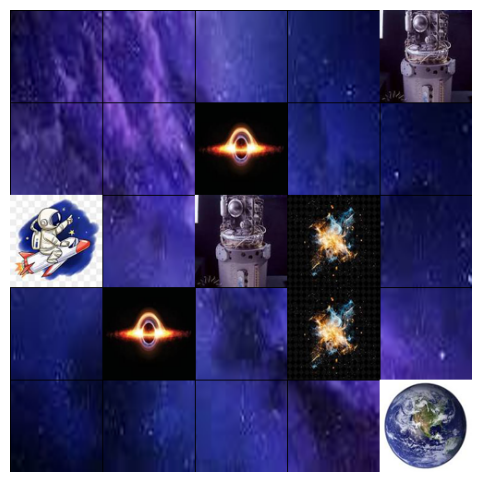



Episode 4 Begins: Initial Position [0 0]
  Step 1: Action Right, New Position [0 1], Reward -1


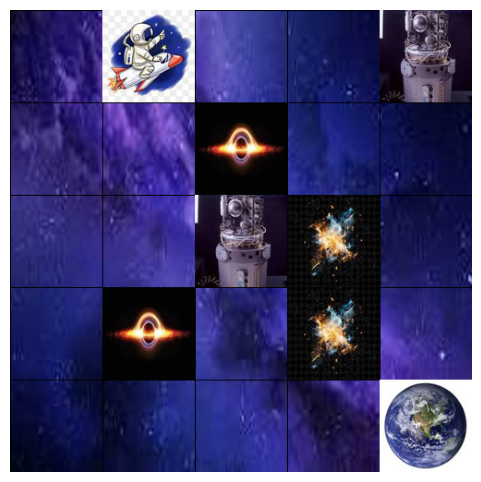

  Step 2: Action Right, New Position [0 2], Reward -1


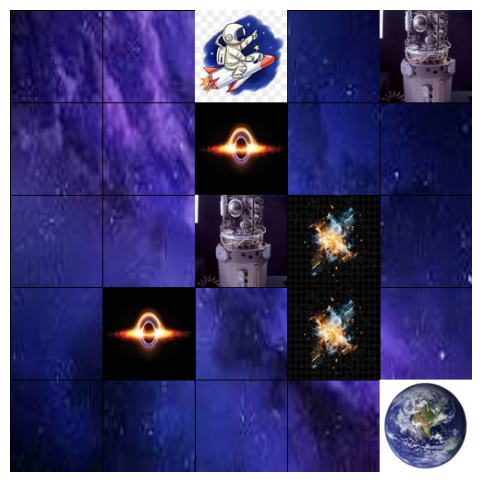

  Step 3: Action Up, New Position [0 2], Reward -1


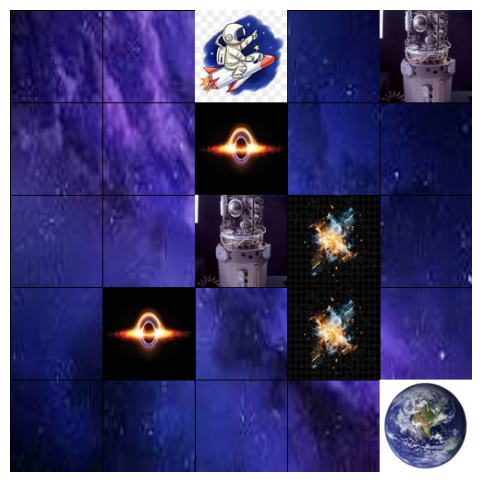

  Step 4: Action Up, New Position [0 2], Reward -1


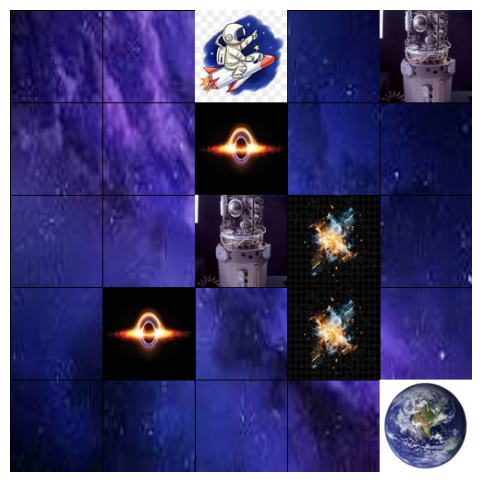

  Step 5: Action Down, New Position [1 2], Reward -51


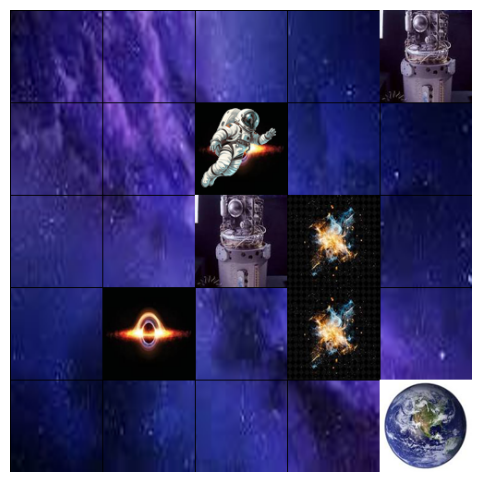

  Failure! Fell into a black hole.


Episode 5 Begins: Initial Position [0 0]
  Step 1: Action Right, New Position [0 1], Reward -1


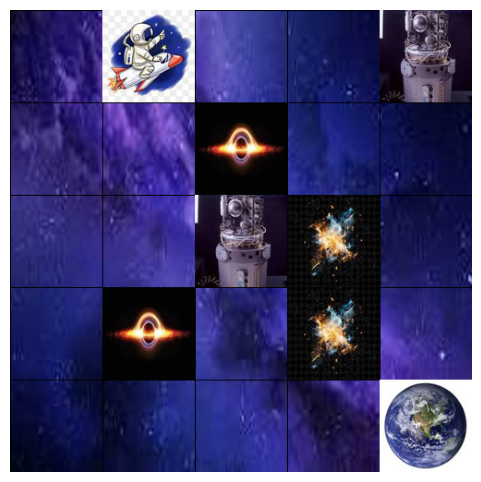

  Step 2: Action Up, New Position [0 1], Reward -1


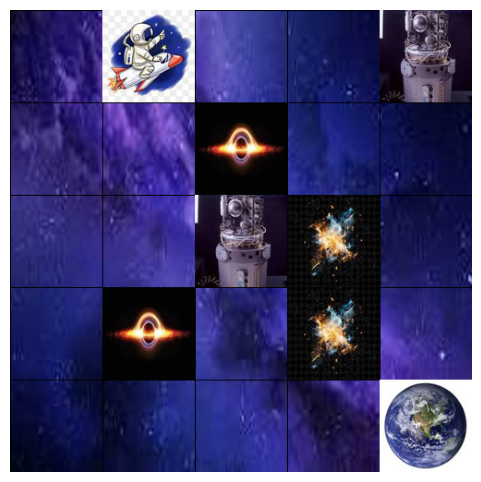

  Step 3: Action Down, New Position [1 1], Reward -1


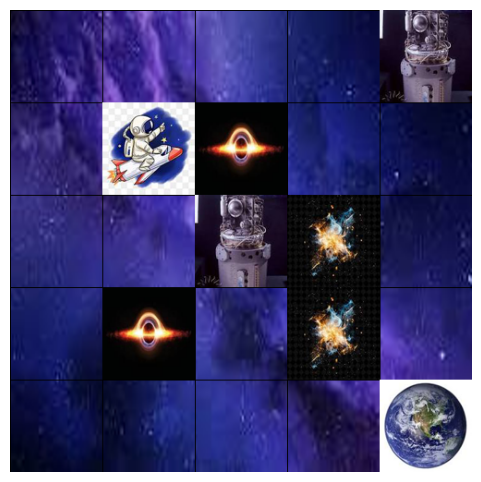

  Step 4: Action Right, New Position [1 2], Reward -51


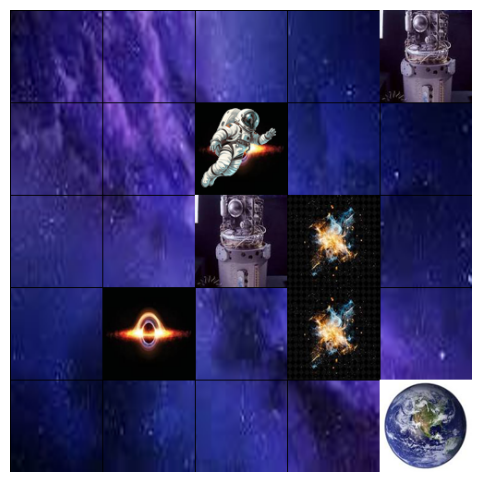

  Failure! Fell into a black hole.


Episode 6 Begins: Initial Position [0 0]
  Step 1: Action Left, New Position [0 0], Reward -1


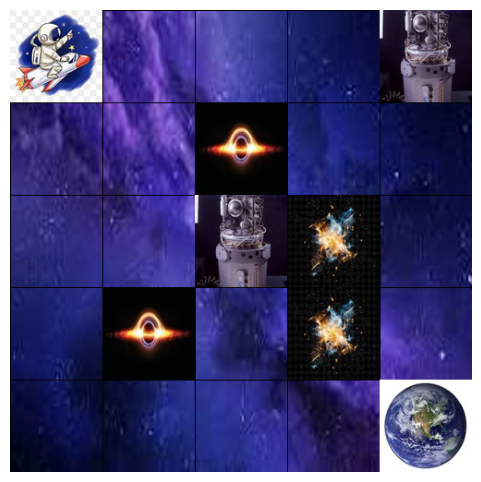

  Step 2: Action Down, New Position [1 0], Reward -1


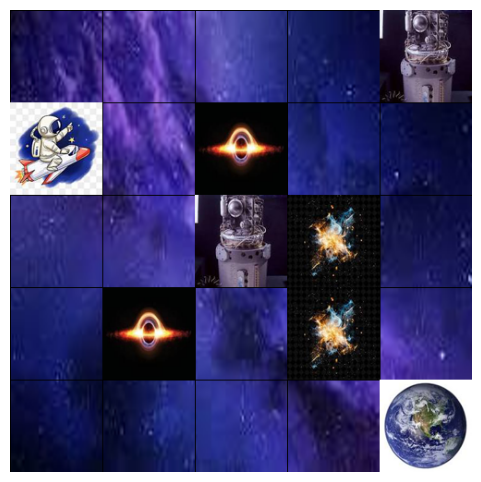

  Step 3: Action Up, New Position [0 0], Reward -1


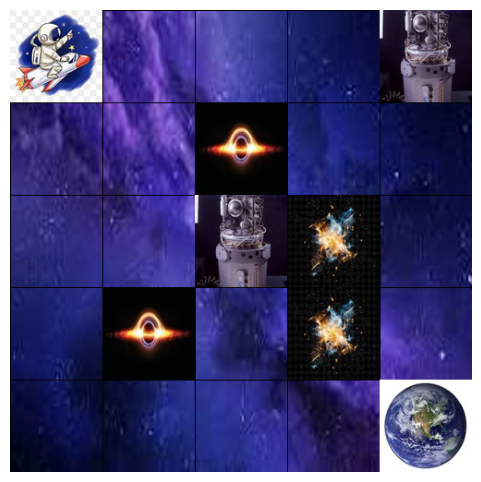

  Step 4: Action Left, New Position [0 0], Reward -1


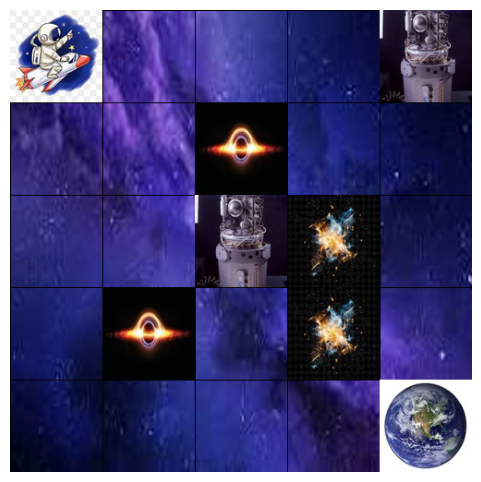

  Step 5: Action Down, New Position [1 0], Reward -1


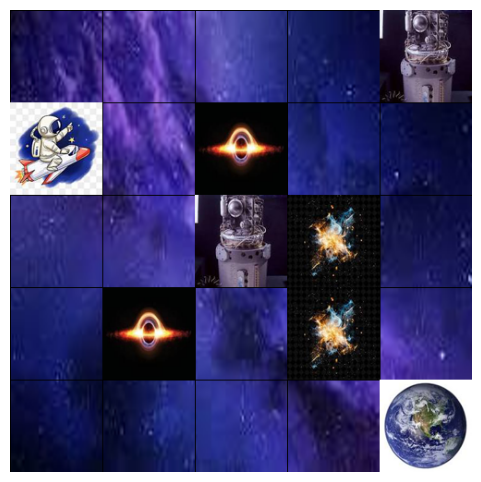

  Step 6: Action Up, New Position [0 0], Reward -1


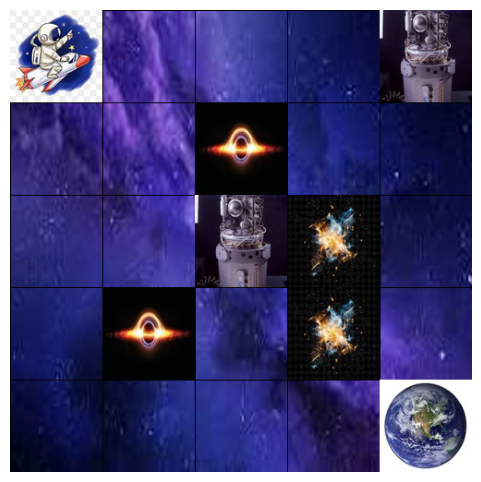

  Step 7: Action Up, New Position [0 0], Reward -1


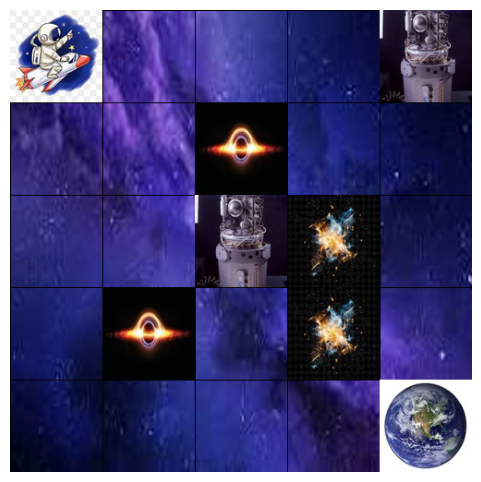

  Step 8: Action Right, New Position [0 1], Reward -1


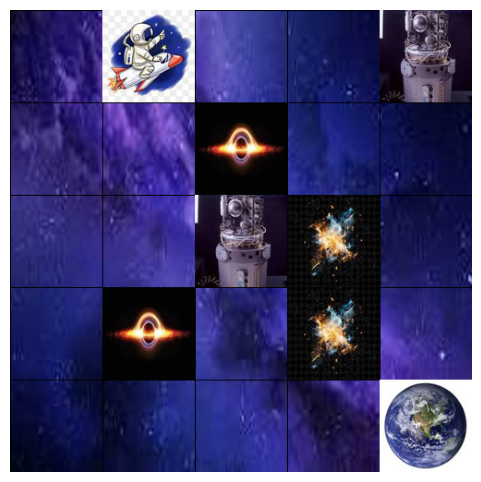

  Step 9: Action Down, New Position [1 1], Reward -1


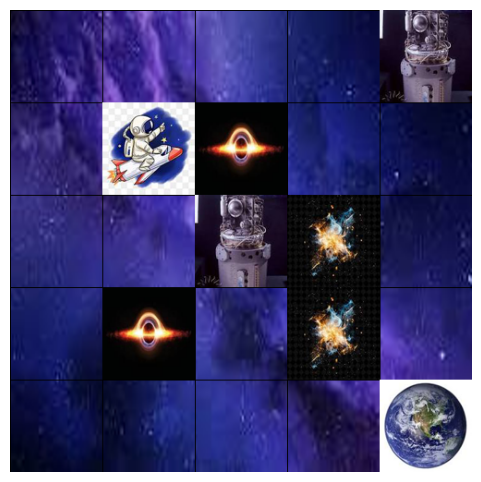

  Step 10: Action Up, New Position [0 1], Reward -1


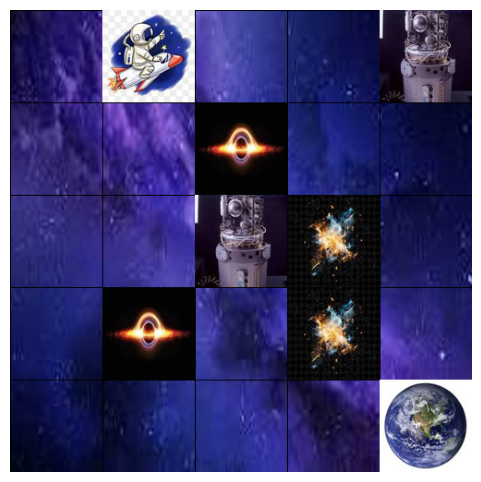



Episode 7 Begins: Initial Position [0 0]
  Step 1: Action Down, New Position [1 0], Reward -1


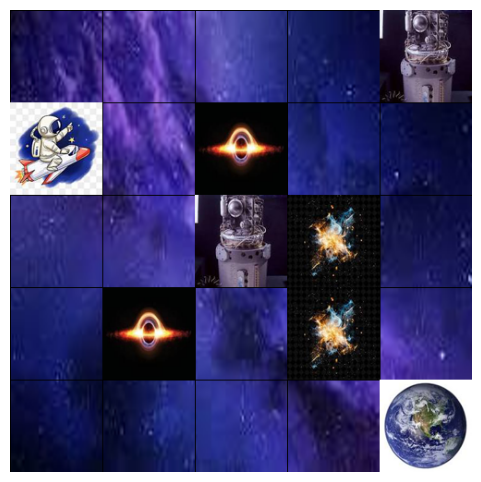

  Step 2: Action Down, New Position [2 0], Reward -1


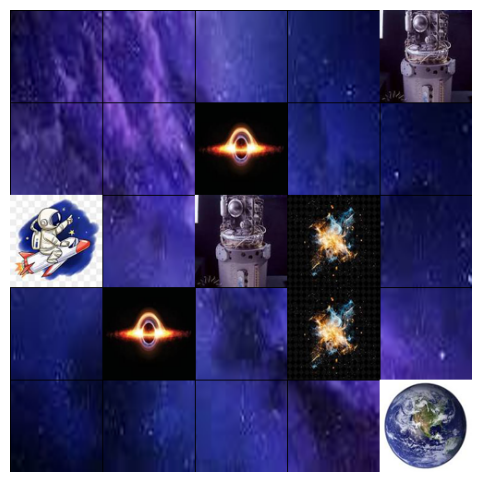

  Step 3: Action Up, New Position [1 0], Reward -1


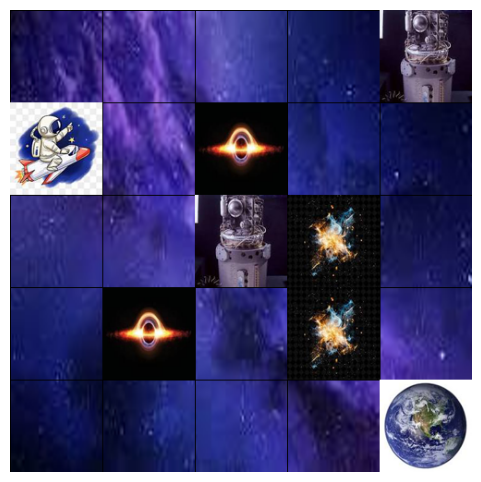

  Step 4: Action Left, New Position [1 0], Reward -1


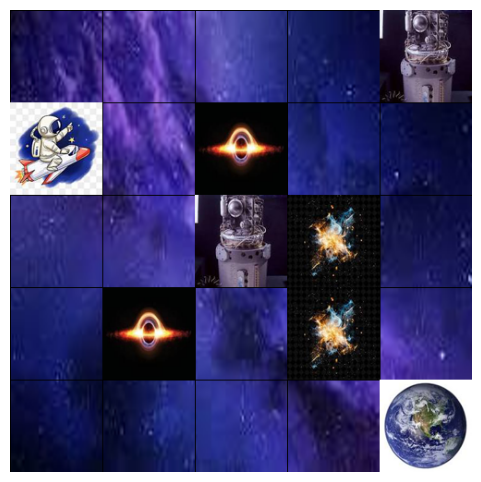

  Step 5: Action Down, New Position [2 0], Reward -1


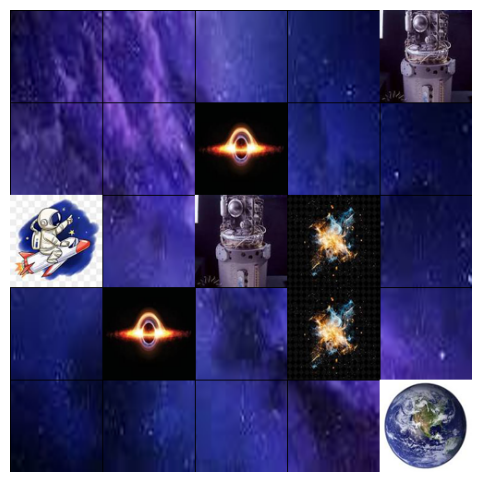

  Step 6: Action Left, New Position [2 0], Reward -1


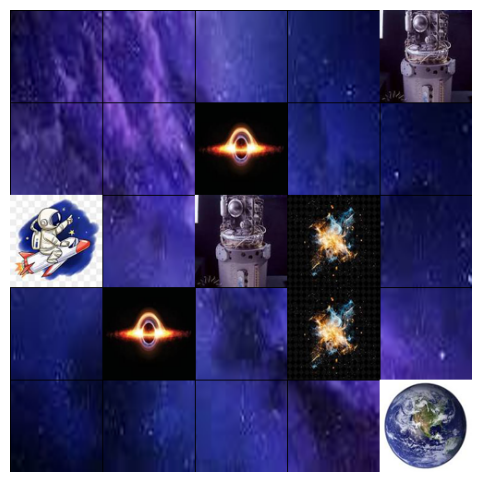

  Step 7: Action Right, New Position [2 1], Reward -1


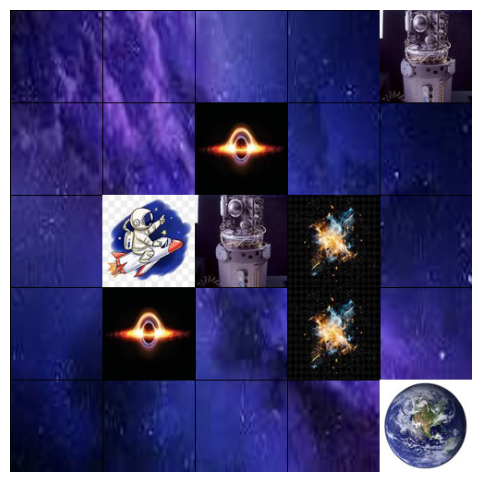

  Step 8: Action Down, New Position [3 1], Reward -51


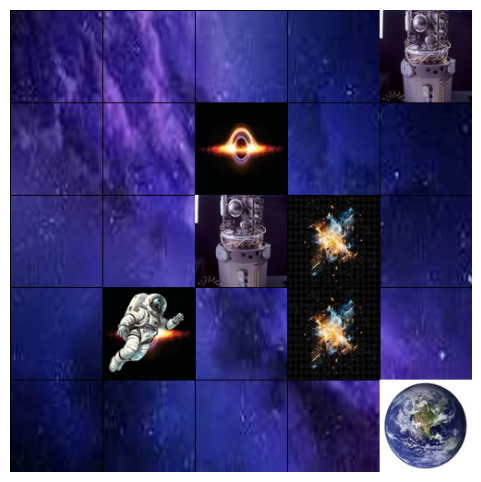

  Failure! Fell into a black hole.


Episode 8 Begins: Initial Position [0 0]
  Step 1: Action Right, New Position [0 1], Reward -1


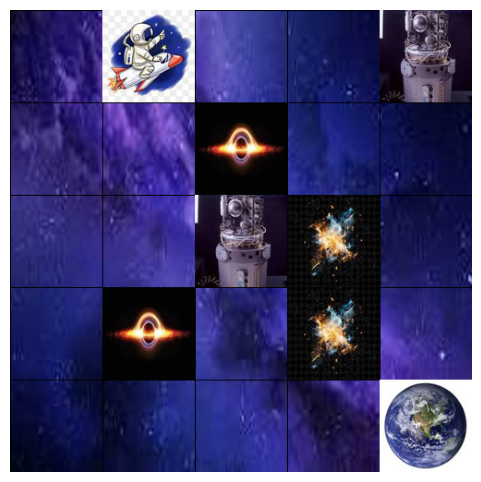

  Step 2: Action Right, New Position [0 2], Reward -1


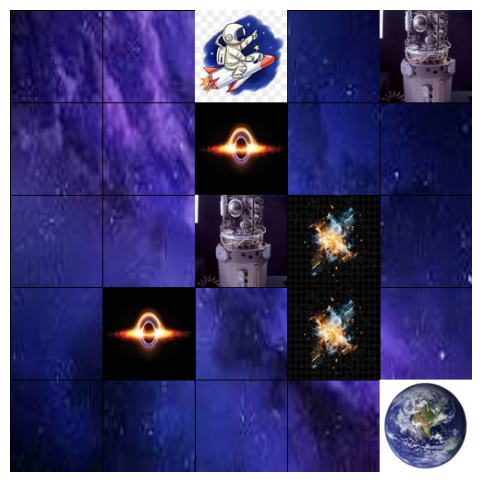

  Step 3: Action Up, New Position [0 2], Reward -1


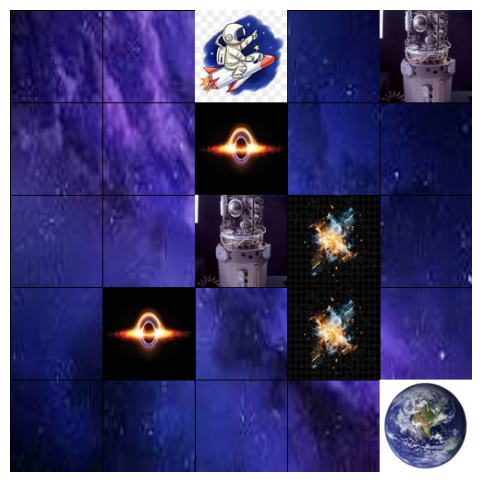

  Step 4: Action Right, New Position [0 3], Reward -1


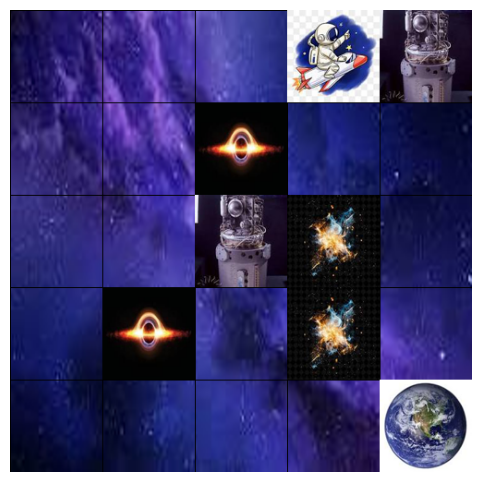

  Step 5: Action Down, New Position [1 3], Reward -1


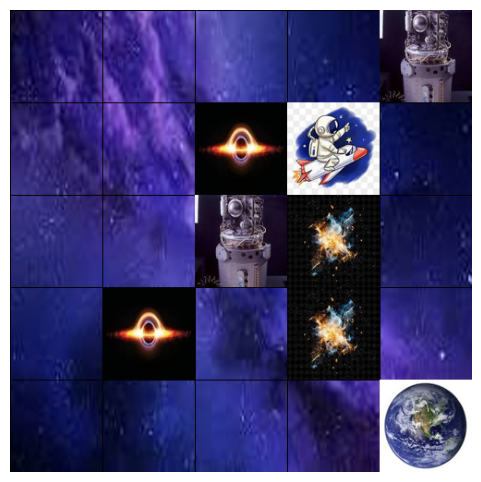

  Step 6: Action Right, New Position [1 4], Reward -1


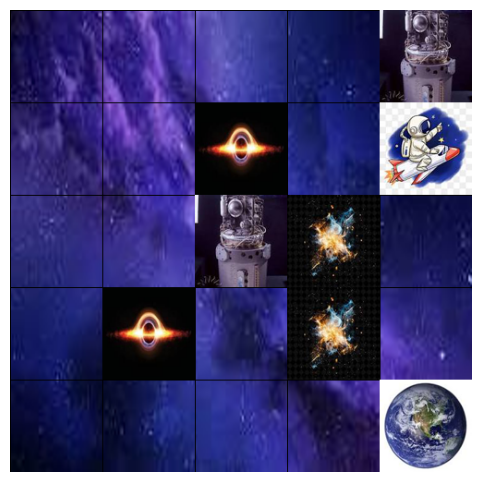

  Step 7: Action Right, New Position [1 4], Reward -1


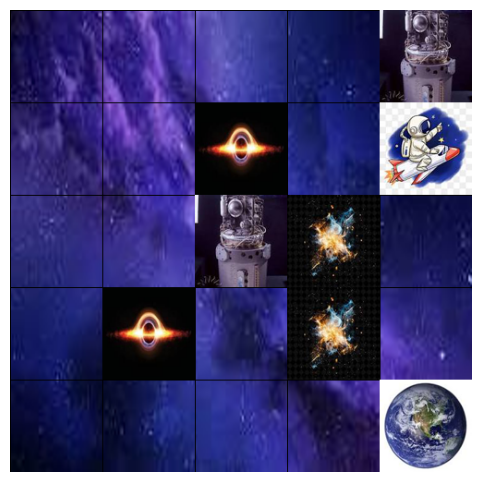

  Step 8: Action Down, New Position [2 4], Reward -1


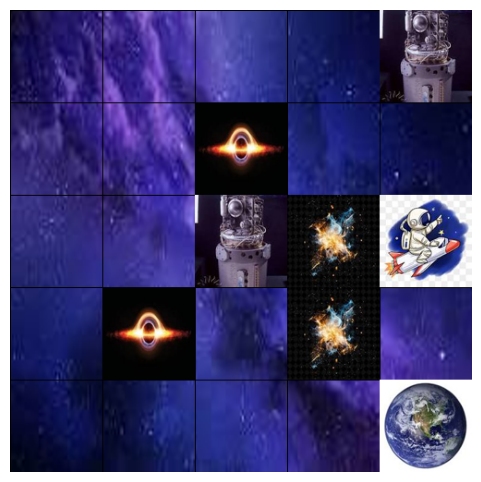

  Step 9: Action Up, New Position [1 4], Reward -1


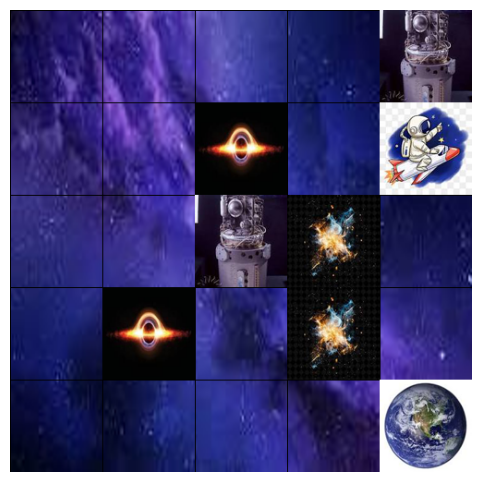

  Step 10: Action Right, New Position [1 4], Reward -1


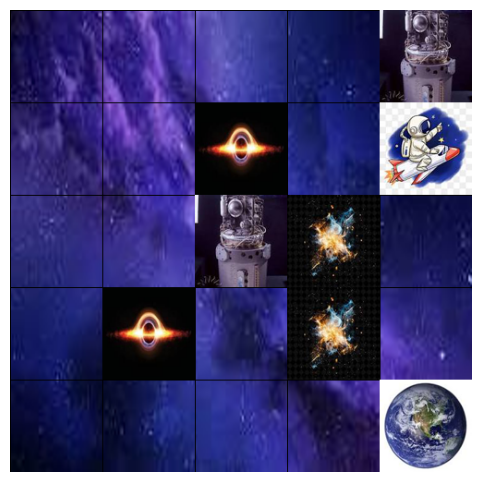



Episode 9 Begins: Initial Position [0 0]
  Step 1: Action Down, New Position [1 0], Reward -1


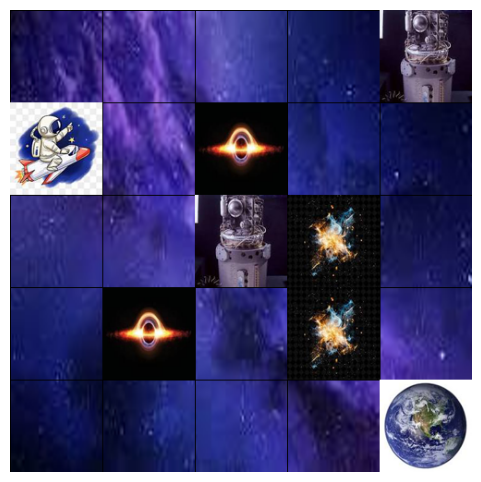

  Step 2: Action Down, New Position [2 0], Reward -1


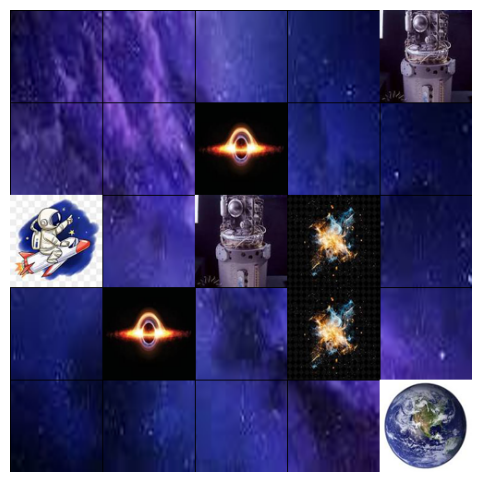

  Step 3: Action Left, New Position [2 0], Reward -1


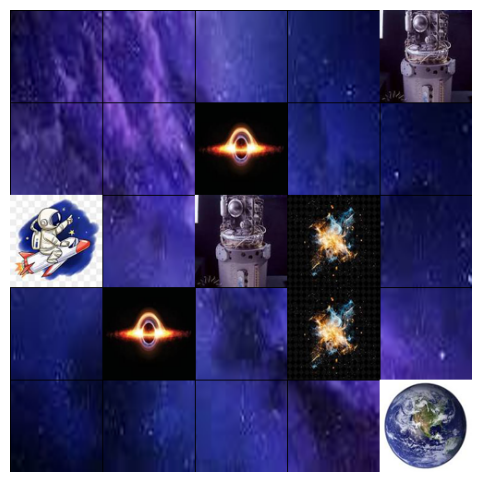

  Step 4: Action Right, New Position [2 1], Reward -1


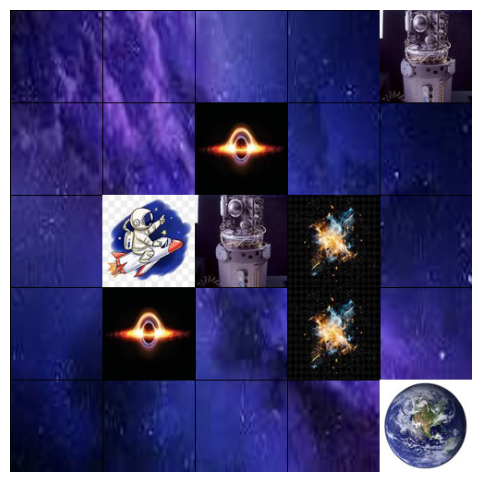

  Step 5: Action Down, New Position [3 1], Reward -51


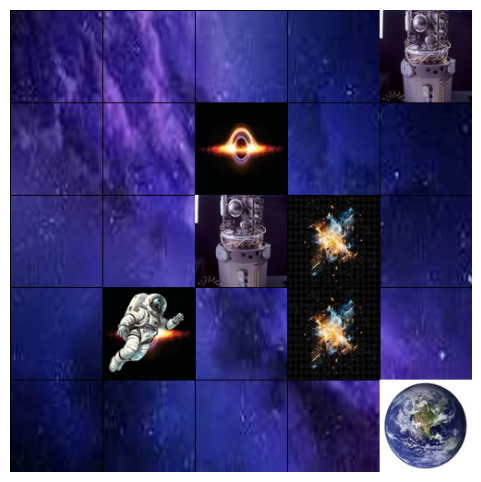

  Failure! Fell into a black hole.


Episode 10 Begins: Initial Position [0 0]
  Step 1: Action Up, New Position [0 0], Reward -1


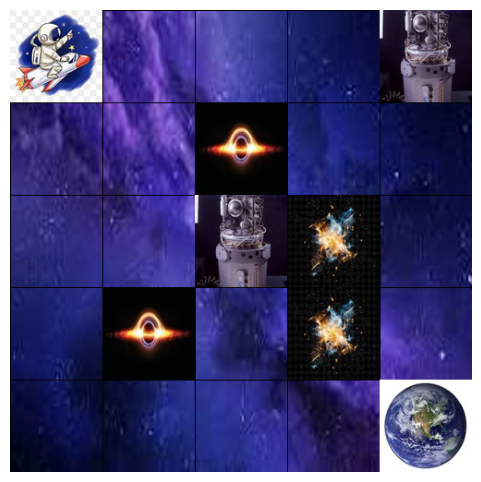

  Step 2: Action Up, New Position [0 0], Reward -1


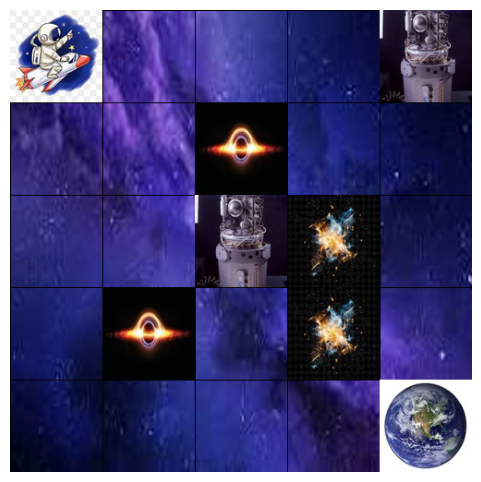

  Step 3: Action Up, New Position [0 0], Reward -1


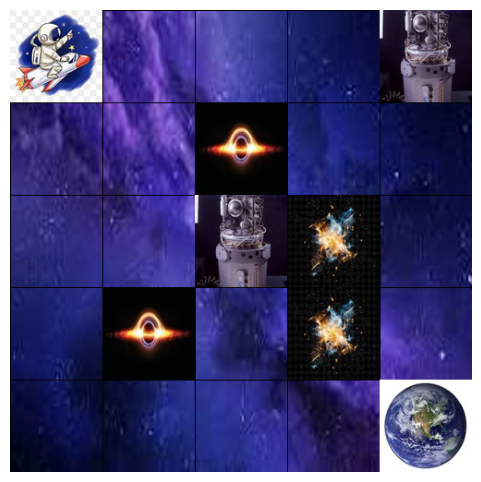

  Step 4: Action Right, New Position [0 1], Reward -1


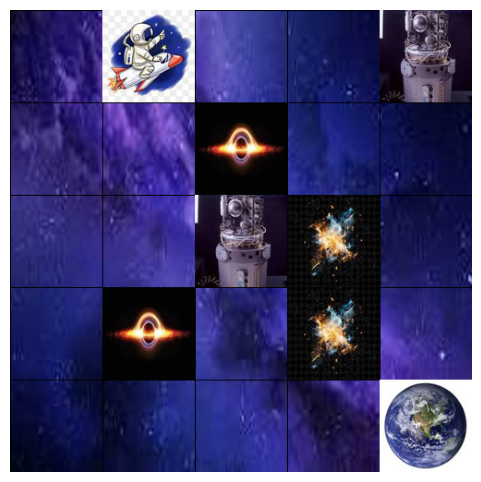

  Step 5: Action Left, New Position [0 0], Reward -1


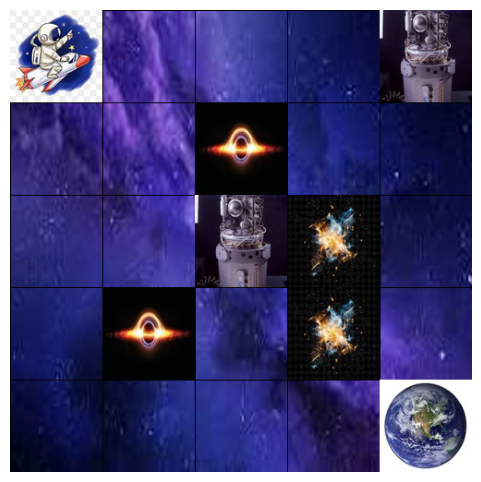

  Step 6: Action Up, New Position [0 0], Reward -1


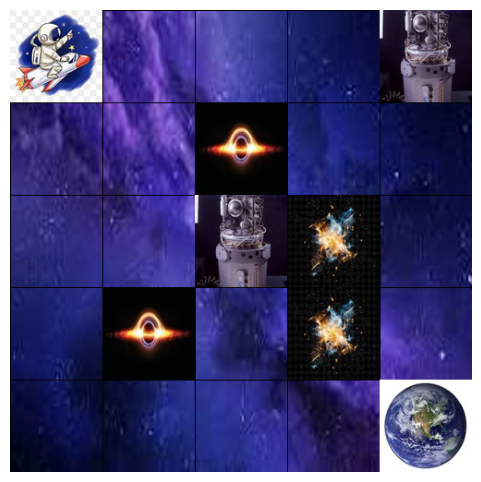

  Step 7: Action Right, New Position [0 1], Reward -1


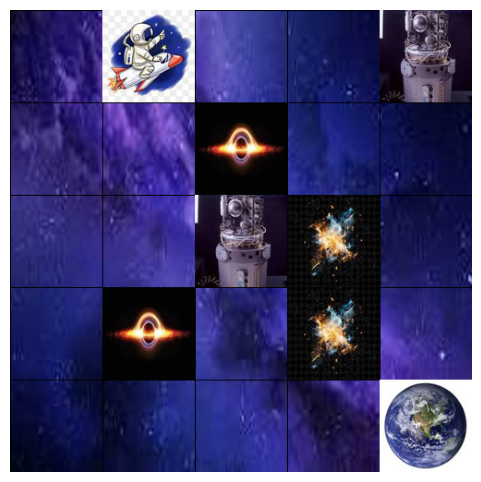

  Step 8: Action Down, New Position [1 1], Reward -1


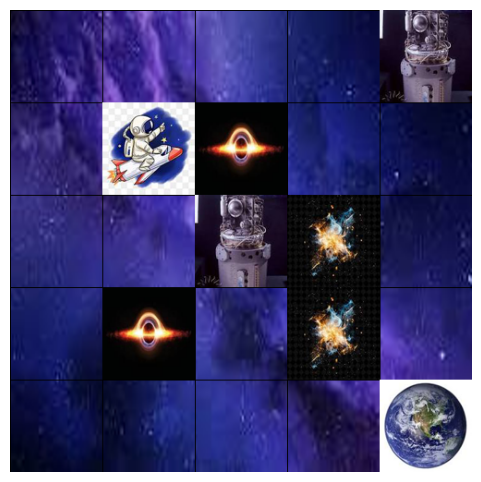

  Step 9: Action Up, New Position [0 1], Reward -1


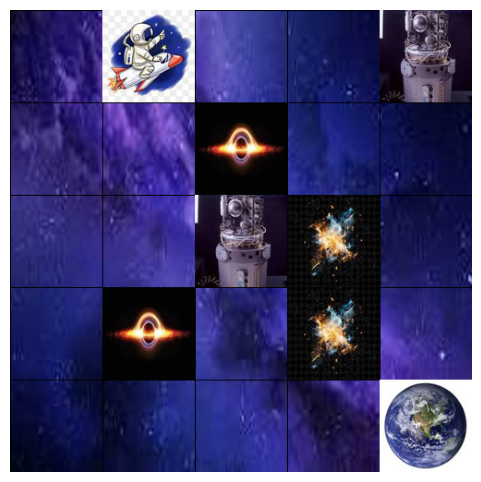

  Step 10: Action Left, New Position [0 0], Reward -1


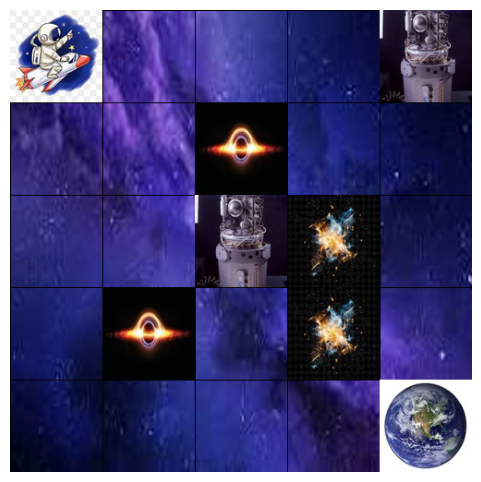

In [9]:
from PIL import Image, ImageDraw
import numpy as np
import random
import matplotlib.pyplot as plt

class SpaceMissionEnvWithImages(SpaceMissionEnv):
    def __init__(self):
        super().__init__()
        # Load images
        self.background_img = Image.open("background.jpg")  # Custom background
        self.agent_img = Image.open("agent_idle.png")       # Agent in idle state
        self.agent_moving_img = Image.open("agent_moving.png")  # Agent in moving state
        self.black_hole_img = Image.open("black_hole.png")  # Black hole image
        self.star_fragment_img = Image.open("star_fragment.png")  # Star fragment image
        self.fuel_cell_img = Image.open("fuel_cell.png")    # Fuel cell image
        self.destination_img = Image.open("destination.png")  # Destination image

        # Resize images to fit grid cells
        self.cell_size = 100  # Grid cell size in pixels
        self.agent_img = self.agent_img.resize((self.cell_size, self.cell_size))
        self.agent_moving_img = self.agent_moving_img.resize((self.cell_size, self.cell_size))
        self.black_hole_img = self.black_hole_img.resize((self.cell_size, self.cell_size))
        self.star_fragment_img = self.star_fragment_img.resize((self.cell_size, self.cell_size))
        self.fuel_cell_img = self.fuel_cell_img.resize((self.cell_size, self.cell_size))
        self.destination_img = self.destination_img.resize((self.cell_size, self.cell_size))
        self.background_img = self.background_img.resize((self.grid_size[1] * self.cell_size, self.grid_size[0] * self.cell_size))

    def render(self, agent_state="idle"):
        # Convert the background to RGBA to ensure compatibility
        grid_img = self.background_img.convert("RGBA")
        draw = ImageDraw.Draw(grid_img)

        # Draw grid
        for y in range(self.grid_size[0]):
            for x in range(self.grid_size[1]):
                draw.rectangle(
                    [x * self.cell_size, y * self.cell_size, (x + 1) * self.cell_size, (y + 1) * self.cell_size],
                    outline="black"
                )

        # Ensure all images are in RGBA format
        black_hole_img = self.black_hole_img.convert("RGBA")
        star_fragment_img = self.star_fragment_img.convert("RGBA")
        fuel_cell_img = self.fuel_cell_img.convert("RGBA")
        destination_img = self.destination_img.convert("RGBA")
        agent_img = (self.agent_img if agent_state == "idle" else self.agent_moving_img).convert("RGBA")

        # Draw objects
        for bh in self.black_holes:
            grid_img.paste(black_hole_img, (bh[1] * self.cell_size, bh[0] * self.cell_size), mask=black_hole_img)

        for sf in self.star_fragments:
            grid_img.paste(star_fragment_img, (sf[1] * self.cell_size, sf[0] * self.cell_size), mask=star_fragment_img)

        for fc in self.fuel_cells:
            grid_img.paste(fuel_cell_img, (fc[1] * self.cell_size, fc[0] * self.cell_size), mask=fuel_cell_img)

        grid_img.paste(destination_img, (self.destination[1] * self.cell_size, self.destination[0] * self.cell_size), mask=destination_img)

        # Draw agent
        grid_img.paste(agent_img, (self.state[1] * self.cell_size, self.state[0] * self.cell_size), mask=agent_img)

        # Display the final image
        plt.figure(figsize=(6, 6))
        plt.imshow(grid_img)
        plt.axis("off")
        plt.show()


# Initialize the environment with images
env_with_images = SpaceMissionEnvWithImages()

# Run the environment for 10 episodes
for episode in range(10):
    state = env_with_images.reset()
    print(f"Episode {episode + 1} Begins: Initial Position {state}")
    done = False

    for t in range(10):  # Limit steps to avoid infinite loops
        action = env_with_images.action_space.sample()
        next_state, reward, done, _ = env_with_images.step(action)
        agent_state = "moving" if reward == -1 else "idle"
        print(f"  Step {t + 1}: Action {['Up', 'Down', 'Left', 'Right'][action]}, New Position {next_state}, Reward {reward}")
        env_with_images.render(agent_state)

        if done:
            print(f"  {'Success! Reached the destination.' if reward > 0 else 'Failure! Fell into a black hole.'}")
            break
    print("\n")
